In [41]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import os

In [42]:
def centroidsDict(centroids, index):
    a = centroids.T[index].sort_values(ascending = False).reset_index().values
    centroid_dict = dict()

    for i in range(0, len(a)):
        centroid_dict.update( {a[i,0] : a[i,1]} )

    return centroid_dict

In [47]:
def generateWordClouds(centroids,save_dir):
    wordcloud = WordCloud(max_font_size=100, background_color = 'white')
    for i in range(0, len(centroids)):
        centroid_dict = centroidsDict(centroids, i)        
        wordcloud.generate_from_frequencies(centroid_dict)

        plt.figure()
        plt.title('Cluster {}'.format(i))
        plt.imshow(wordcloud)
        plt.axis("off")
        plt.savefig(os.path.join(save_dir,f"cluster{i}"))

In [55]:
def savewordclouds(clustercenter_dir,vectors,save_dir):
    vectors = pd.read_csv(vectors)
    for filename in os.listdir(clustercenter_dir):
        if filename.endswith('.csv'):
            filepath = os.path.join(clustercenter_dir,filename)
        temp = pd.read_csv(filepath)
        temp.columns = vectors.columns
        filename = filename.split(".")[0]
        savepath = os.path.join(save_dir,filename)
        if not os.path.exists(savepath):
            os.makedirs(savepath)
        generateWordClouds(temp,savepath)
        

In [56]:
cluster_dir = r"E:\Projects\National Anthems\lists\clustercenters"
image_dir = r"E:\Projects\National Anthems\images\mapofwords"
vectors = r"E:\Projects\National Anthems\data\vectors.csv"

C:\Users\ANUJ BELGAONKAR\AppData\Local\Temp\ipykernel_18920\706536444.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


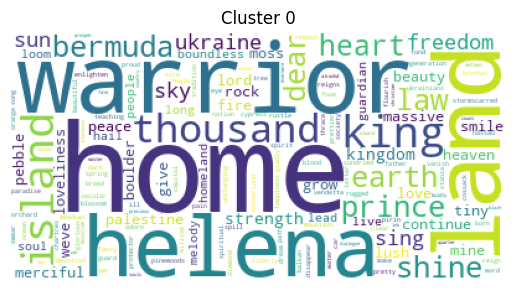

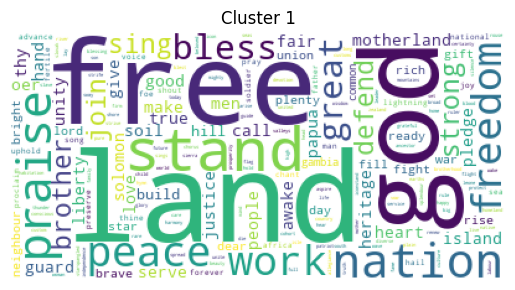

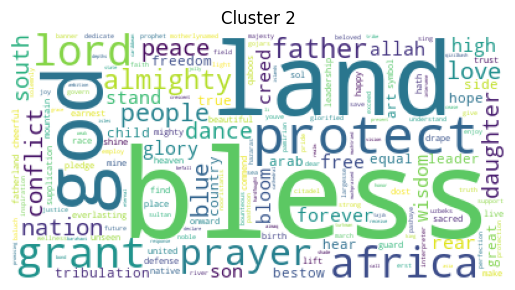

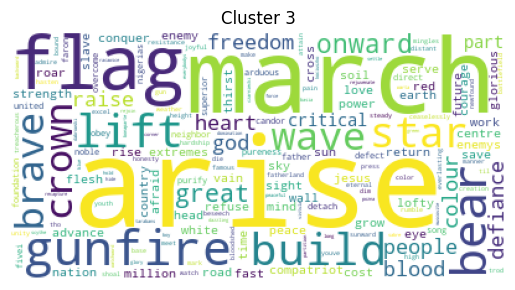

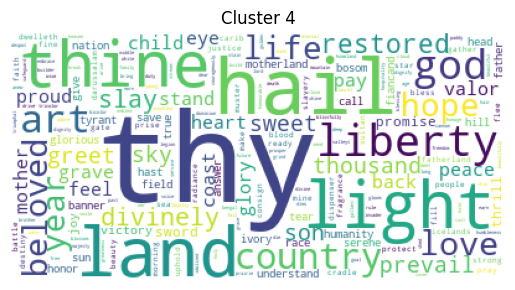

...

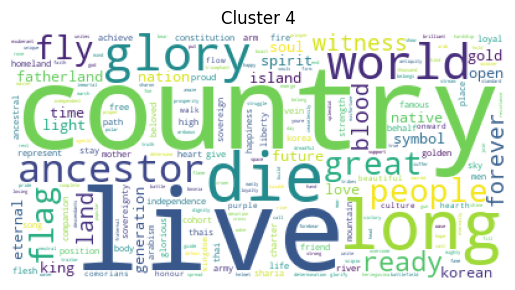

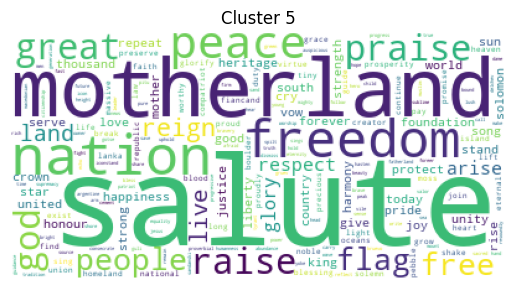

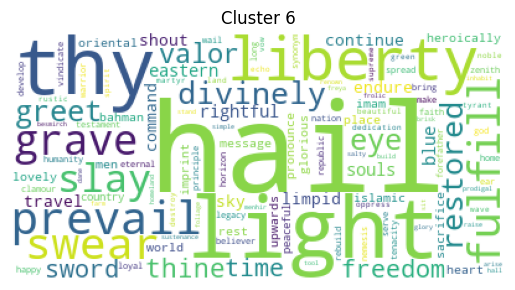

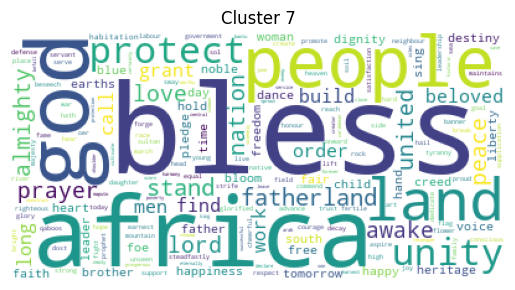

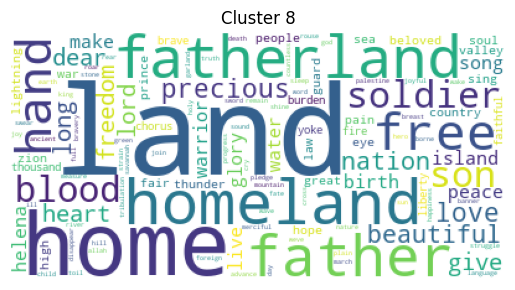

In [57]:
savewordclouds(cluster_dir,vectors,image_dir)